In [1]:
%matplotlib inline
from nuscenes.nuscenes import NuScenes
import matplotlib.pyplot as plt

nusc = NuScenes(version='v1.0-mini', dataroot='/imec/other/dl4ms/nicule52/datasets/nuscenes/v1.0-mini/', verbose=True)
# nusc = NuScenes(version='v1.0-trainval', dataroot='/imec/other/dl4ms/nicule52/datasets/nuscenes/full-v1.0/', verbose=True)
nusc.list_scenes()



/imec/other/dl4ms/nicule52/miniconda3/envs/t-nusc/lib/python3.11/site-packages/numpy/core/getlimits.py:549: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/imec/other/dl4ms/nicule52/miniconda3/envs/t-nusc/lib/python3.11/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/imec/other/dl4ms/nicule52/miniconda3/envs/t-nusc/lib/python3.11/site-packages/numpy/core/getlimits.py:549: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/imec/other/dl4ms/nicule52/miniconda3/envs/t-nusc/lib/python3.11/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subno

Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 0.412 seconds.
Reverse indexing ...
Done reverse indexing in 0.1 seconds.
scene-0061, Parked truck, construction, intersectio... [18-07-24 03:28:47]   19s, singapore-onenorth, #anns:4622
scene-0103, Many peds right, wait for turning car, ... [18-08-01 19:26:43]   19s, boston-seaport, #anns:2046
scene-0655, Parking lot, parked cars, jaywalker, be... [18-08-27 15:51:32]   20s, boston-seaport, #anns:2332
scene-0553, Wait at intersection, bicycle, large tr... [18-08-28 20:48:16]   20s, boston-seaport, #anns:1950
scene-0757, Arrive at busy intersection, bus, wait ... [18-08-30 19:25:08]   20s, boston-seaport, #anns:592
scene-0796, Scooter, peds on sidewalk, bus, cars, t... [18-10-02 02:52:24]   20s, singapore-queensto, #anns:708
scene-0916, Parki

In [2]:
my_scene = nusc.scene[0]
# my_scene = nusc.scene[6]
my_scene


{'token': 'cc8c0bf57f984915a77078b10eb33198',
 'log_token': '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
 'nbr_samples': 39,
 'first_sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'last_sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'name': 'scene-0061',
 'description': 'Parked truck, construction, intersection, turn left, following a van'}

In [3]:
# nusc.render_sample(my_scene['first_sample_token'])

SAMPLE:
{'token': 'ca9a282c9e77460f8360f564131a8af5', 'timestamp': 1532402927647951, 'prev': '', 'next': '39586f9d59004284a7114a68825e8eec', 'scene_token': 'cc8c0bf57f984915a77078b10eb33198', 'data': {'RADAR_FRONT': '37091c75b9704e0daa829ba56dfa0906', 'RADAR_FRONT_LEFT': '11946c1461d14016a322916157da3c7d', 'RADAR_FRONT_RIGHT': '491209956ee3435a9ec173dad3aaf58b', 'RADAR_BACK_LEFT': '312aa38d0e3e4f01b3124c523e6f9776', 'RADAR_BACK_RIGHT': '07b30d5eb6104e79be58eadf94382bc1', 'LIDAR_TOP': '9d9bf11fb0e144c8b446d54a8a00184f', 'CAM_FRONT': 'e3d495d4ac534d54b321f50006683844', 'CAM_FRONT_RIGHT': 'aac7867ebf4f446395d29fbd60b63b3b', 'CAM_BACK_RIGHT': '79dbb4460a6b40f49f9c150cb118247e', 'CAM_BACK': '03bea5763f0f4722933508d5999c5fd8', 'CAM_BACK_LEFT': '43893a033f9c46d4a51b5e08a67a1eb7', 'CAM_FRONT_LEFT': 'fe5422747a7d4268a4b07fc396707b23'}, 'anns': ['ef63a697930c4b20a6b9791f423351da', '6b89da9bf1f84fd6a5fbe1c3b236f809', '924ee6ac1fed440a9d9e3720aac635a0', '91e3608f55174a319246f361690906ba', 'cd05172

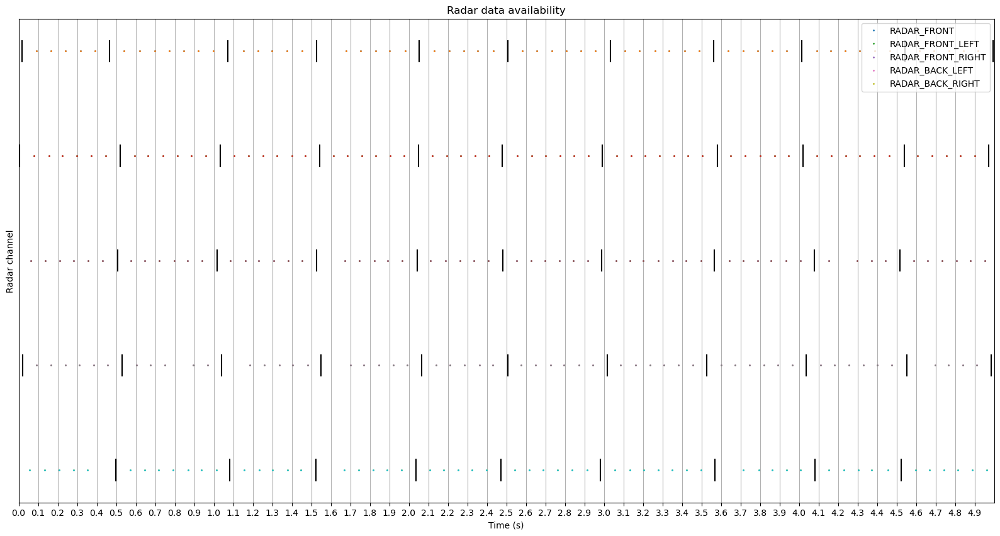

Total time: 19.149566 s
Total samples: 38.0
Sample freq: 1.9843791760084797 Hz
Total sweeps: 251.6
Sweep freq: 13.138678965361407 Hz


In [4]:
import numpy as np


first_sample_token = my_scene['first_sample_token']
x = nusc.get('sample', first_sample_token)
print('SAMPLE:')
print(x)
t0 = x['timestamp']

timestamps = {}

for radar_channel, channel_tok in x['data'].items():
    if "RADAR" not in radar_channel:
        continue
    y = nusc.get('sample_data', channel_tok)
    timestamps[radar_channel] = []
    print('SAMPLE_DATA:')
    print(y)
    while y['next'] != '':
        # print((y['timestamp'] - t0) / 1e6)
        timestamps[radar_channel].append(((y['timestamp'] - t0) / 1e6, bool(y['is_key_frame'])))
        y = nusc.get('sample_data', y['next'])


fig = plt.figure(figsize=(20, 10))
plt.yticks([])
#increase legend size
plt.ylabel('Radar channel')

plt.xlabel('Time (s)')
plt.title('Radar data availability')

total_sample = 0
total_sweep = 0

for idx, (radar_channel, channel_timestamps) in enumerate(timestamps.items()):
    x, y = zip(*channel_timestamps)
    y = np.array(y).astype(bool)
    sweep_x = np.array(x).astype(float)[y == False]
    sample_x = np.array(x).astype(float)[y == True]

    total_sample += len(sample_x)
    total_sweep += len(sweep_x) + len(sample_x)
    plt.plot(sweep_x, np.full(len(sweep_x), 4 - idx), label=radar_channel, marker='o', linestyle='None', markersize=1)
    plt.plot(sweep_x, np.full(len(sweep_x), 4 - idx), marker='o', linestyle='None', markersize=1)
    #plot vertical black lines for sample x
    for i in range(len(sample_x)):
        plt.plot([sample_x[i], sample_x[i]], [4 - idx - 0.1, 4 - idx + 0.1], color='black')
    print(radar_channel)
    #add legend
    
    #remove labels from y axis
plt.legend(loc='upper right')
plt.xlim(0, 5)
plt.xticks(np.arange(0, 5, 0.1))
plt.grid()
plt.show()

total_time = (nusc.get('sample', my_scene['last_sample_token'])['timestamp'] - nusc.get('sample', my_scene['first_sample_token'])['timestamp']) / 1e6
print(f"Total time: {total_time} s")

total_sample /= len(timestamps.keys())
total_sweep /= len(timestamps.keys())

print(f"Total samples: {total_sample}")
print(f"Sample freq: {total_sample / total_time} Hz")
print(f"Total sweeps: {total_sweep}")
print(f"Sweep freq: {total_sweep / total_time} Hz")


In [5]:
# x = nusc.get('sample', first_sample_token)
# t0 = x['timestamp']
# while x['next'] != '':
#     print((x['timestamp'] - t0) / 1e6)
#     # print(x['next'])
#     x = nusc.get('sample', x['next'])

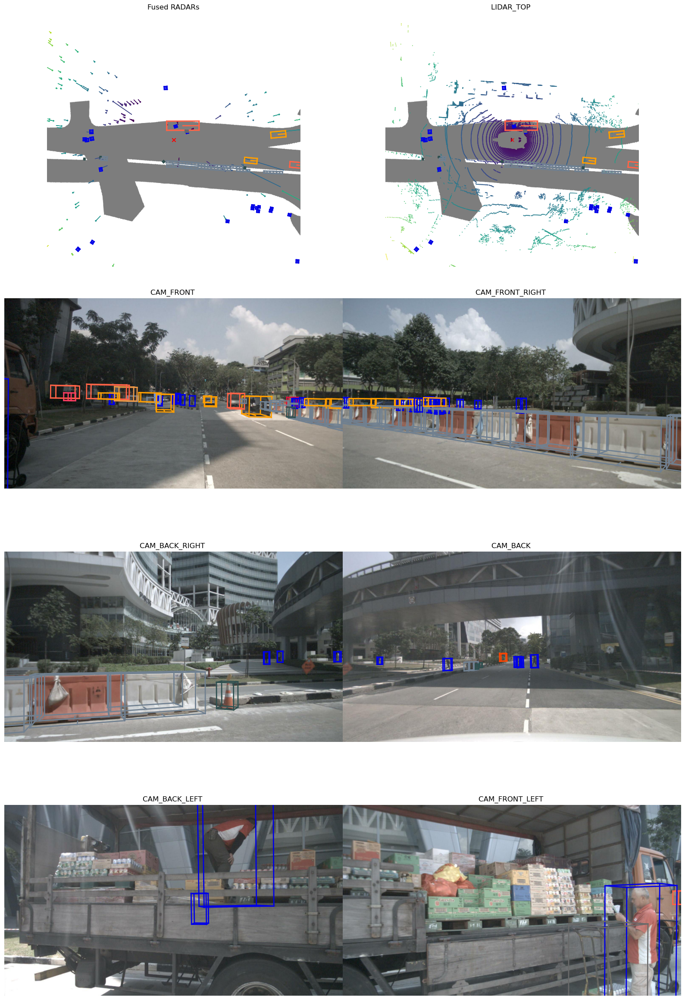

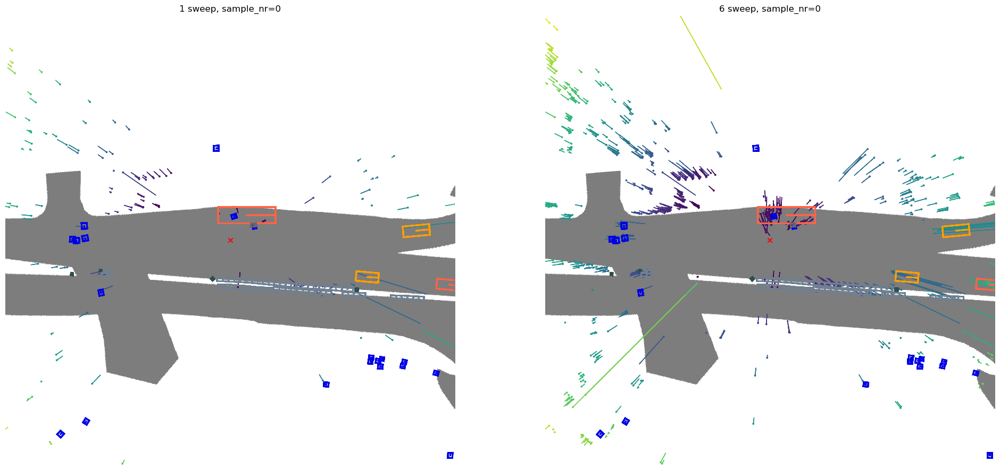

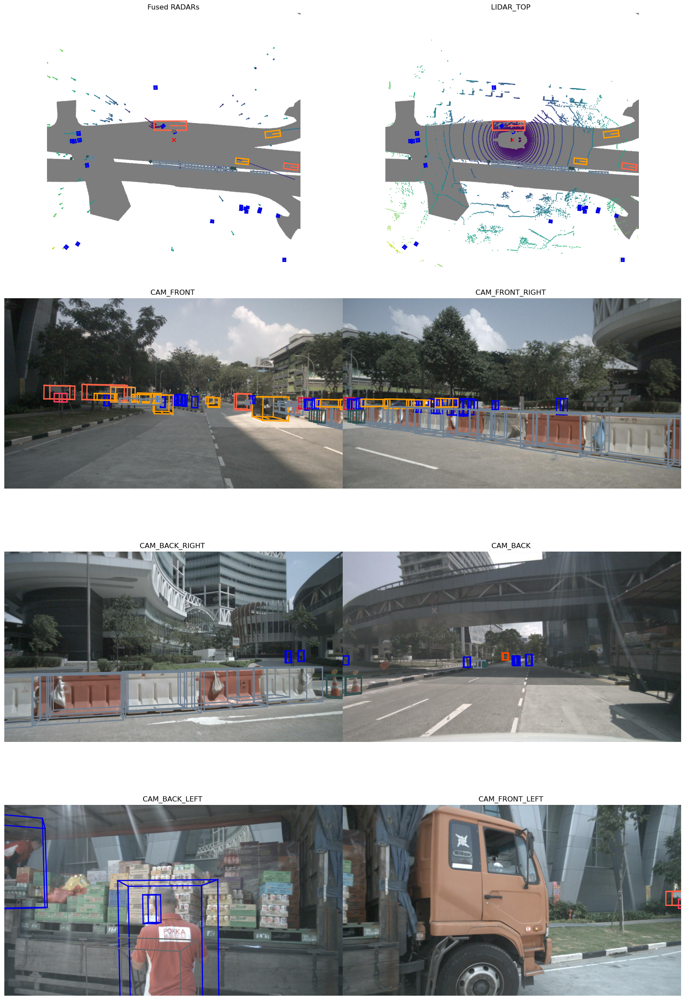

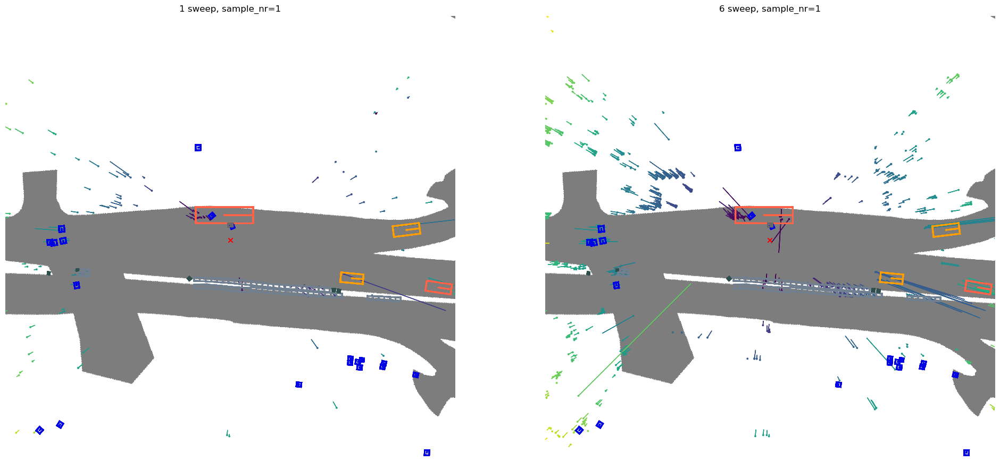

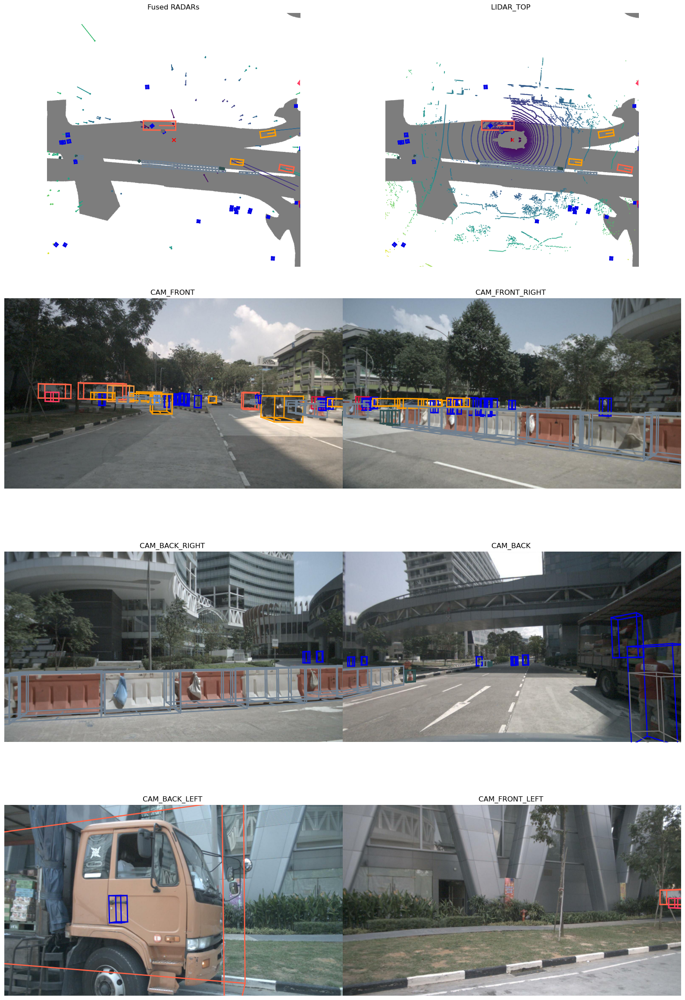

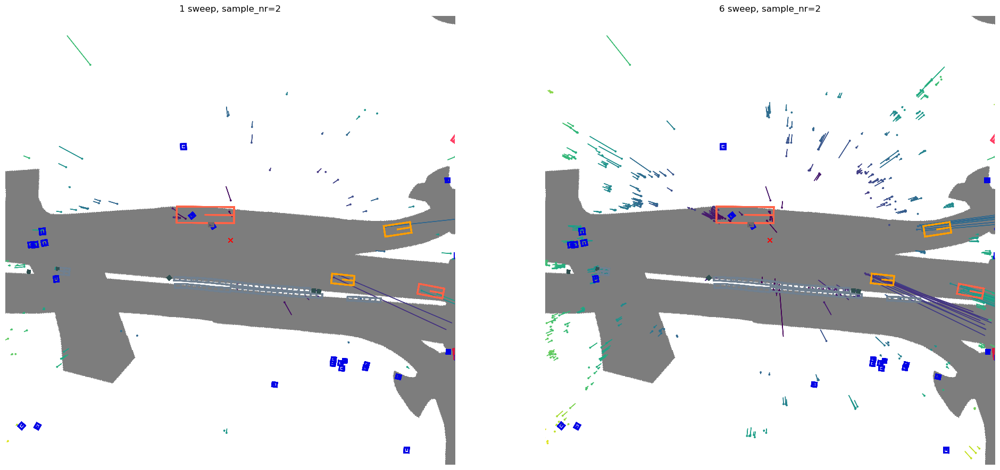

In [6]:
import matplotlib.pyplot as plt
from nuscenes.utils.data_classes import RadarPointCloud
from nuscenes.utils.geometry_utils import BoxVisibility
# RadarPointCloud.disable_filters()
RadarPointCloud.default_filters()

my_sample = nusc.get('sample', first_sample_token)
my_sample = nusc.get('sample', my_sample['next'])
my_sample = nusc.get('sample', my_sample['next'])
my_sample = nusc.get('sample', my_sample['next'])
radar_data = {}

# for _ in range(my_scene['nbr_samples']):
for num_sample in range(3):
    #collect tokens for all radars from annotated sample
    for channel, token in my_sample['data'].items():
        sd_record = nusc.get('sample_data', token)
        sensor_modality = sd_record['sensor_modality']

        if sensor_modality == 'radar':
            radar_data[channel] = token

    # if num_sample == 0 or num_sample == 20:
    nusc.render_sample(my_sample['token'], box_vis_level=BoxVisibility.ANY)
    if num_sample in range(20, 25) or num_sample in range(0, 5):
        fig, ax = plt.subplots(1, 2, figsize = (24, 12))
    
        # for each radar, plot nsweeps behind starting from sample
        if len(radar_data) > 0:
            for i, (_, sd_token) in enumerate(radar_data.items()):
                nusc.render_sample_data(sd_token, with_anns=True, ax=ax[0], nsweeps=1, verbose=False)
                ax[0].set_title("1 sweep, sample_nr={}".format(num_sample))
                nusc.render_sample_data(sd_token, with_anns=True, ax=ax[1], nsweeps=6, verbose=False)
                ax[1].set_title("6 sweep, sample_nr={}".format(num_sample))

    my_sample = nusc.get('sample', my_sample['next'])
    radar_data = {}

RadarPointCloud.default_filters()



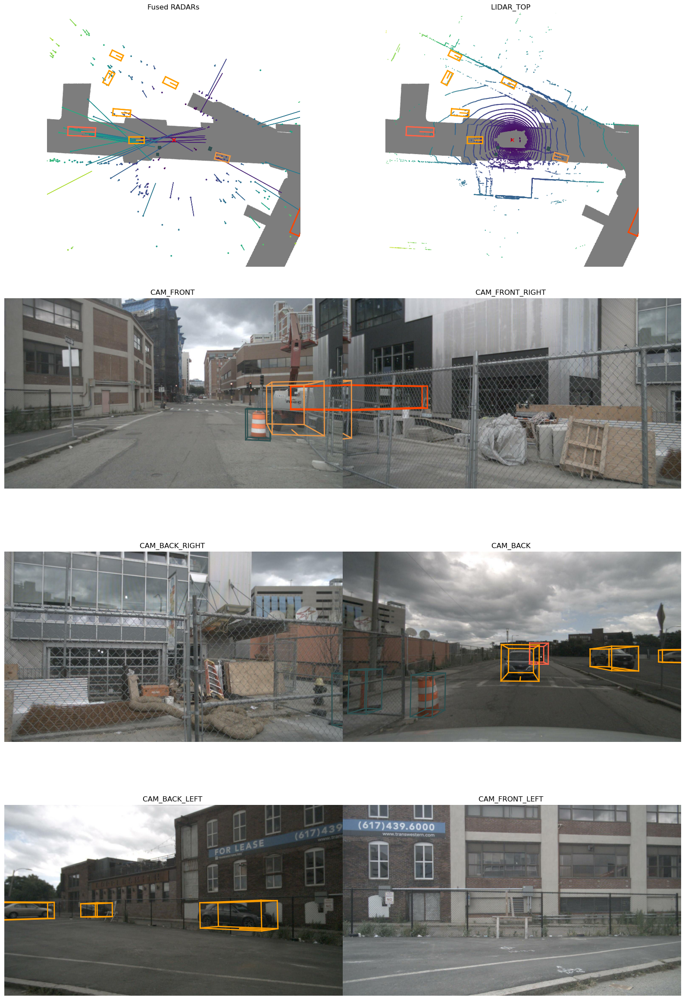

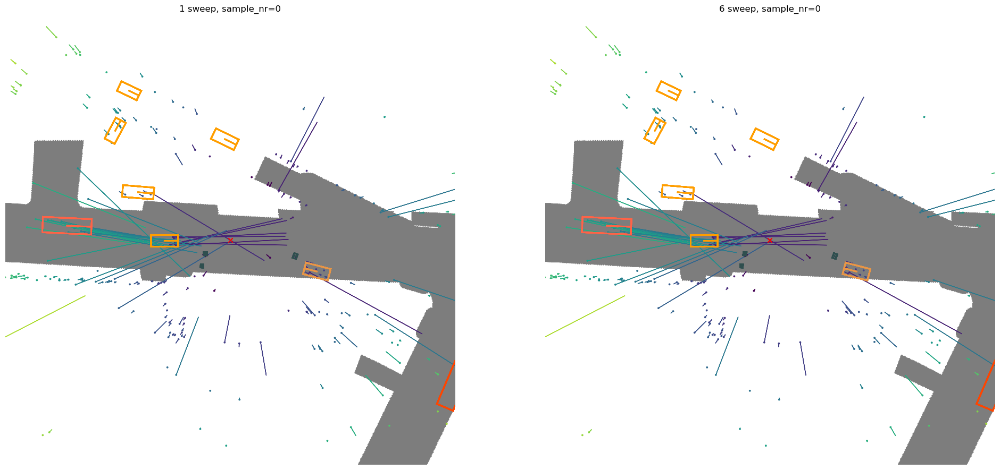

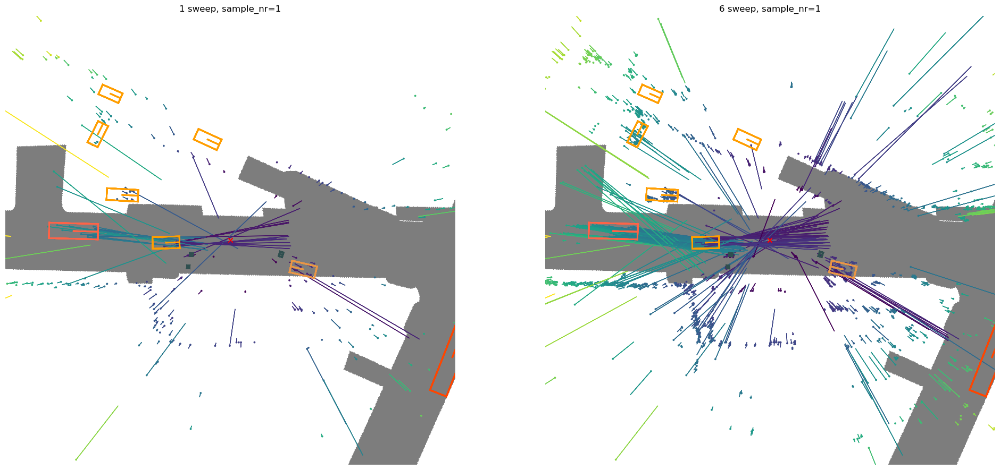

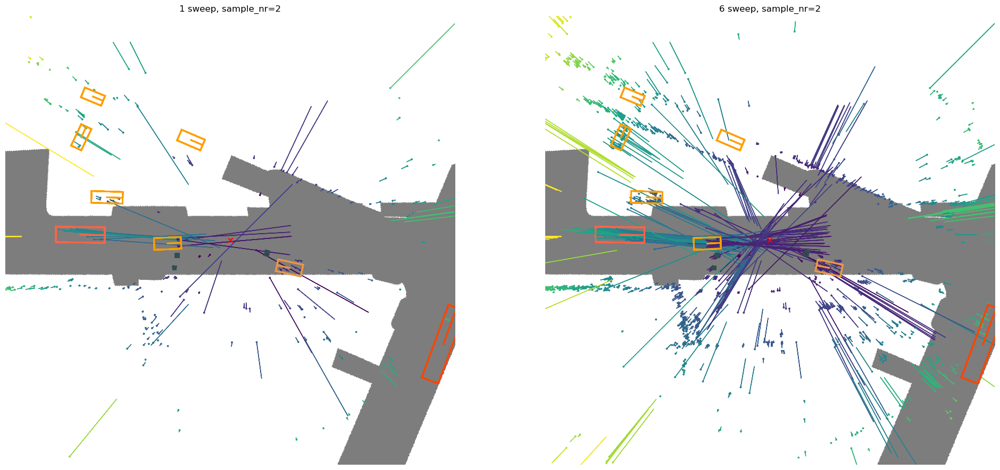

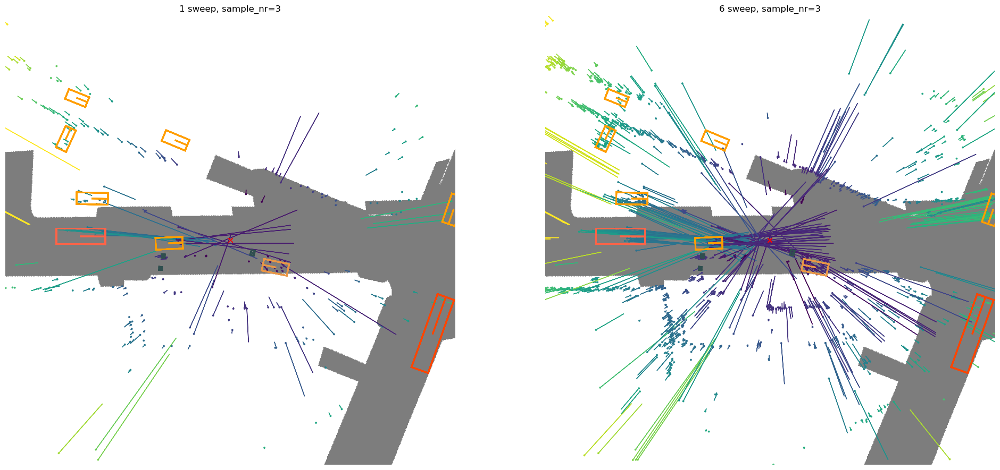

...

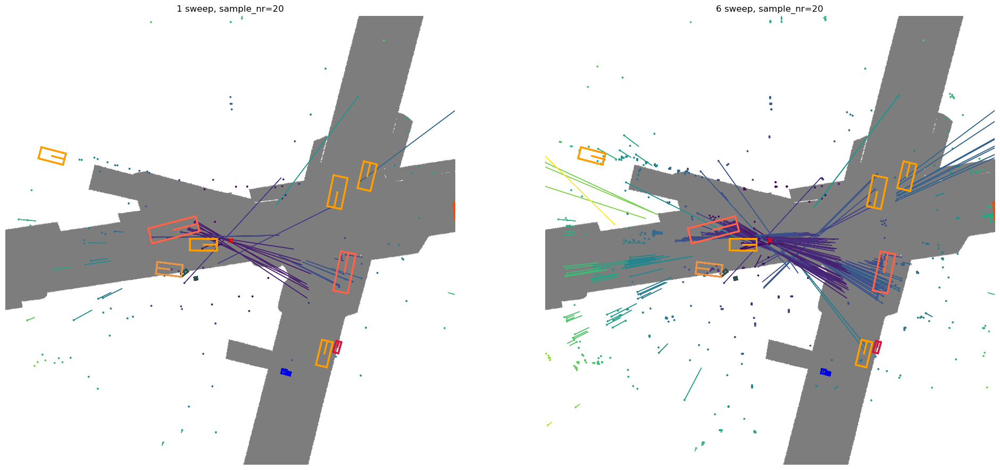

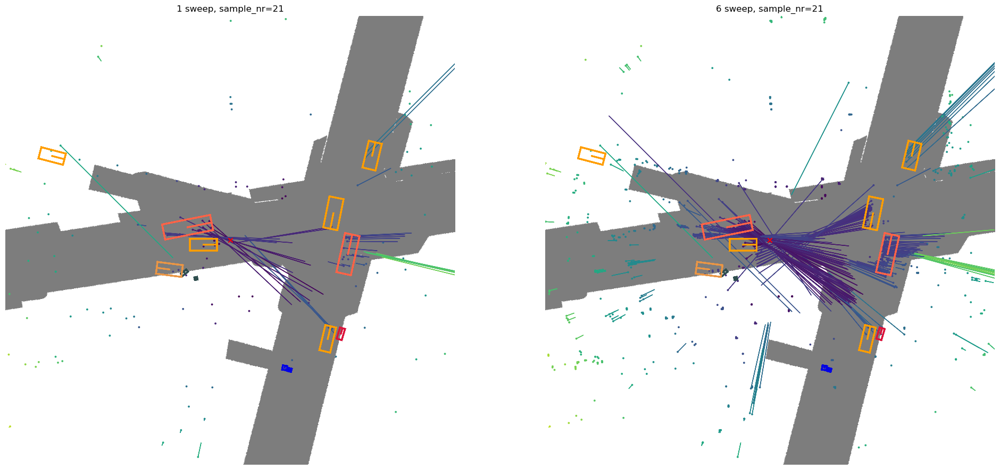

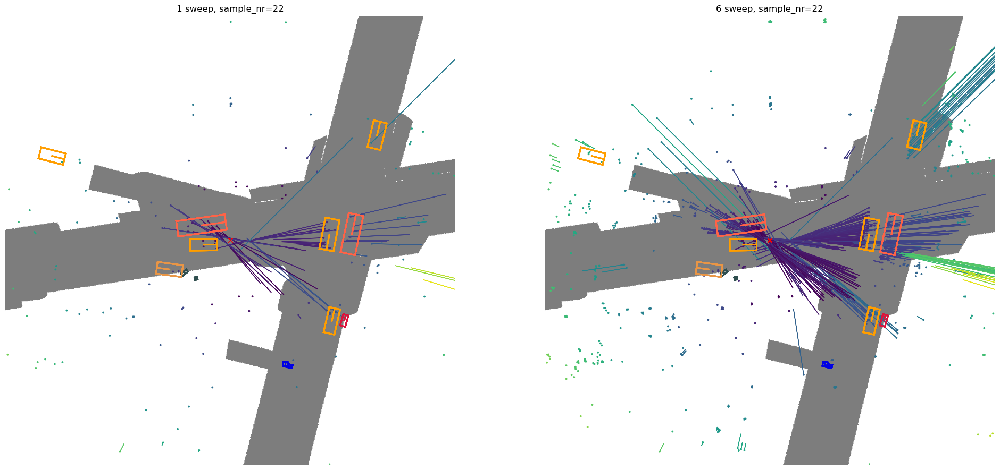

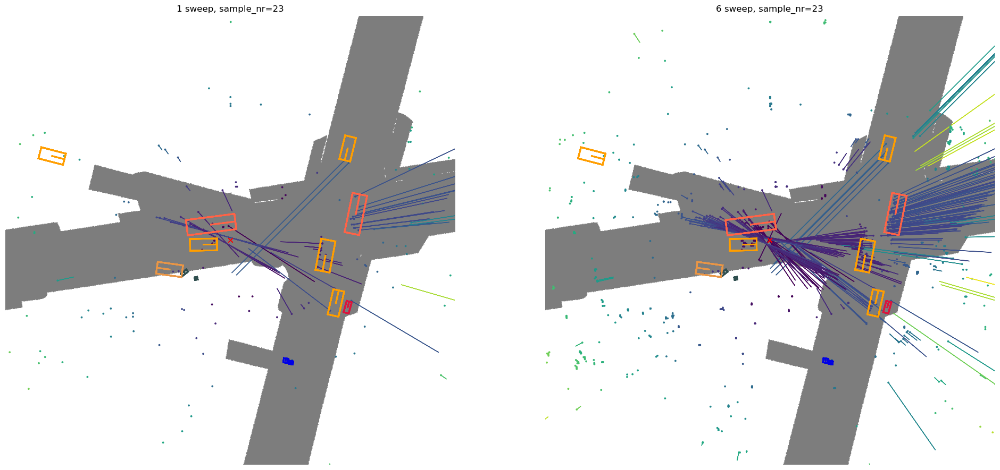

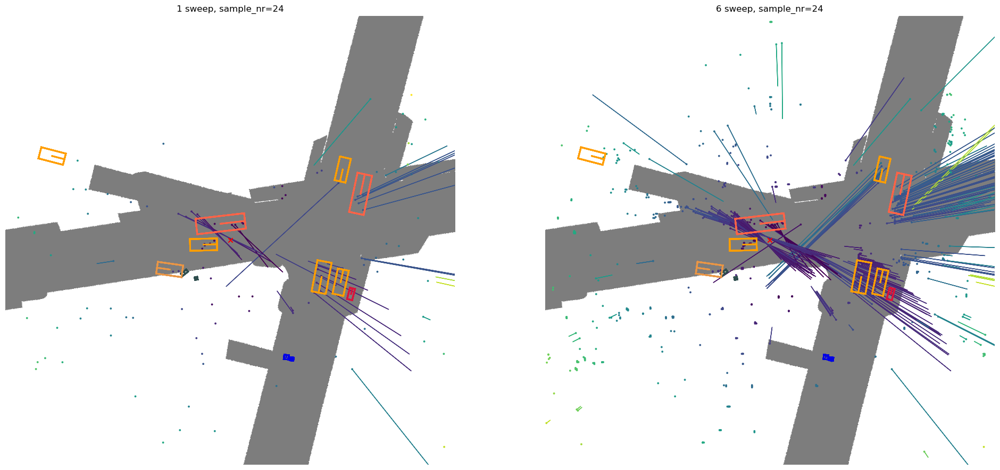

In [27]:
import matplotlib.pyplot as plt
from nuscenes.utils.data_classes import RadarPointCloud
RadarPointCloud.disable_filters()
# RadarPointCloud.default_filters()

my_sample = nusc.get('sample', first_sample_token)
radar_data = {}

# for _ in range(my_scene['nbr_samples']):
for num_sample in range(40):
    #collect tokens for all radars from annotated sample
    for channel, token in my_sample['data'].items():
        sd_record = nusc.get('sample_data', token)
        sensor_modality = sd_record['sensor_modality']

        if sensor_modality == 'radar':
            radar_data[channel] = token

    if num_sample == 0 or num_sample == 20:
        nusc.render_sample(my_sample['token'])
    if num_sample in range(20, 25) or num_sample in range(0, 5):
        fig, ax = plt.subplots(1, 2, figsize = (24, 12))
    
        # for each radar, plot nsweeps behind starting from sample
        if len(radar_data) > 0:
            for i, (_, sd_token) in enumerate(radar_data.items()):
                nusc.render_sample_data(sd_token, with_anns=True, ax=ax[0], nsweeps=1, verbose=False)
                ax[0].set_title("1 sweep, sample_nr={}".format(num_sample))
                nusc.render_sample_data(sd_token, with_anns=True, ax=ax[1], nsweeps=6, verbose=False)
                ax[1].set_title("6 sweep, sample_nr={}".format(num_sample))

    my_sample = nusc.get('sample', my_sample['next'])
    radar_data = {}

RadarPointCloud.default_filters()

